# Introduccion al dataset

El dataset propuesto propuesto proviene de: https://www.propertypriceregister.ie/ y contiene datos de transacciones inmobiliarias en Irlanda desde 2010 hasta la actualidad.

En Irlanda las zonas estan organizadas en 139 identificadores de Ruta unicos associados al codigo postal llamado EIRCODE.
Los primeros 3 elementos de este codigo son siempre el identificador de ruta y los 4 siguientes representan de manera unica la propiedad.
Por desgracia la base de datos de EIRCODEs es paga ($3000 eu) con lo cual no podre utilizarla en este proceso pero podria ser una herramienta para mejorar la calidad de lo datos de llegar a convertir esto en un producto.

# Objetivo personal y motivacion

Hace unos años mientras vivia en Irl se me ocurrio desarrollar una AI capaz de realizar calculos de rentabilidad economica al momento de realizar una transaccion inmobiliaria. Los posibles usos serian multiples:

1- Entender en que valor deberias posicionar un inmueble que quieres vender.

2- Validar si el precio de un inmuelble esta por debajo, arriba o valor de mercado.

3- Buscar potentenciales inmuebles que tengan un indice de rentabilidad alto.

4- Estipular el valor de un inmueble a futuro

5- Entender la tendencia del mercado inmobiliario (a la suba o baja) para saber si es momento de alquilar, comprar o vender


Este servicio se podria ofrecer al publico directo con una serie de opciones gratuitas y de manera paga (premiun) con informacion mas detallada en diferentes categorias.

# Enfoque de este trabajo

Se busca que los datos contengan 3 campos principales: Valor de la transaccion, Fecha, ID de ruta y tamaño aprox de la propiedad. 

La data esta bastante incompleta, especialemente los primeros años de carga, se buscara incrementar el nivel de completitud de 17% a un 80%.

Para esto se emplearan varios pasos:

1- Normalizacion y limpieza de los campos

2- Conversion de la direccion (Address) a sus componentes Street, Neighbourhood, Area tanto sea posible ya que no tiene una estructura fija

3- Conversion de la calles (Street) a su correspondiente numero (si existe) y calle

4- Enriquesimiento de datos conociendo los codigos de ruta (esto es publico y esta en wikipedia) y sus correspondientes ciudades y pueblos

5- Enriquesimiento de datos antiguos usando las entradas actuales que podeen el ERICODE, llamare a esto reconocimiento de vecinos (neighbour)

Una vez procesada la data se organizaran los elementos por codigo de ruta y se aplicaran diferentes analisis matematicos para calcular los precios historicos y futuros por codigo de ruta.

Se espera que al final una simple funcion dado un EIRCODE y el Tamaño de la propiedad pueda estimar el costo minimo, medio y maximo de una dicha propiedad.

# Primera impresion del dataset

El dataset contiene aprox 725k entradas, el campo fecha y valor esta siempre presente.

El campor address varia bastante en estructura pero tambien es el que mas informacion provee.

El mayor desafio sera competar los codigos de ruta y el tamaño de las propiedades.

Mapa de Rutas de Dublin

![IRL MAP](https://upload.wikimedia.org/wikipedia/commons/thumb/1/19/EircodeDublin.svg/1024px-EircodeDublin.svg.png)

# Imports para todo el proyecto

In [1]:
import numpy as np
import pandas as pd
import zipfile # para descomprimir archivos zip
import urllib.request # para descargar de URL
from os import path as osp
import re
import ssl

# Descarga y carga del dataset

In [2]:

# download dataset 
ruta = osp.join("res", "PPR-ALL.zip")
url = 'https://www.propertypriceregister.ie/website/npsra/ppr/npsra-ppr.nsf/Downloads/PPR-ALL.zip/$FILE/PPR-ALL.zip'  
ssl._create_default_https_context = ssl._create_unverified_context

# Descargar usando un contexto SSL sin verificación
with urllib.request.urlopen(url, context=ssl._create_unverified_context()) as response, open(ruta, 'wb') as out_file:
	out_file.write(response.read())

# Unzip file
ruta_ext = osp.join("res")
with zipfile.ZipFile(ruta, 'r') as z: 
    print('Extracting all files...') 
    z.extractall(ruta_ext)
print('Done!')



Extracting all files...
Done!


In [3]:
# download eircodes
ruta = osp.join("res", "eircodes.csv")
url = 'https://raw.githubusercontent.com/peraltarh/VIUMasterInAI/main/2.Python%20para%20la%20inteligencia%20artificial/Trabajo_procesamiento_dataset/res/eircodes.csv'
ssl._create_default_https_context = ssl._create_unverified_context

with urllib.request.urlopen(url, context=ssl._create_unverified_context()) as response, open(ruta, 'wb') as out_file:
    out_file.write(response.read())

In [4]:

# download irl map 
ruta = osp.join("res", "IRLadm.zip")
url = 'https://raw.githubusercontent.com/peraltarh/VIUMasterInAI/main/2.Python%20para%20la%20inteligencia%20artificial/Trabajo_procesamiento_dataset/res/IRLadm.zip'
ssl._create_default_https_context = ssl._create_unverified_context

# Descargar usando un contexto SSL sin verificación
with urllib.request.urlopen(url, context=ssl._create_unverified_context()) as response, open(ruta, 'wb') as out_file:
	out_file.write(response.read())

# Unzip file
ruta_ext = osp.join("res")
with zipfile.ZipFile(ruta, 'r') as z: 
    print('Extracting all files...') 
    z.extractall(ruta_ext)
print('Done!')


Extracting all files...
Done!


In [5]:
# Load dataset
ruta_csv = osp.join("res", "PPR-ALL.csv")
properties_dataset = pd.read_csv(ruta_csv, sep=',', header=0, engine='python', encoding='latin1')


In [6]:
# Load Eircode CSV -- This was obtained from wikipedia
eircodes_ruta = osp.join("res", "eircodes.csv")
eircodes_csv = pd.read_csv(eircodes_ruta, sep=',', header=0, engine='python')

eircodes_csv['PostTown'] = eircodes_csv['PostTown'].str.strip().str.lower()
eircodes_csv['PostCounty'] = eircodes_csv['PostCounty'].str.strip().str.lower()
eircodes_csv['RoutingKey'] = eircodes_csv['RoutingKey'].str.strip().str.lower()

# Normalizacion y limpieda de los campos

In [7]:
# Process dataset

properties_dataset = properties_dataset.drop('Not Full Market Price', axis=1)
properties_dataset = properties_dataset.drop('VAT Exclusive', axis=1)

# Format Date -  Date of Sale (dd/mm/yyyy)
properties_dataset = properties_dataset.rename(columns={'Date of Sale (dd/mm/yyyy)': 'Date'})
properties_dataset['Date'] = pd.to_datetime(properties_dataset['Date'], format='%d/%m/%Y', errors='coerce')

# Format Price -Price ()
properties_dataset = properties_dataset.rename(columns={'Price ()': 'Price'})
#properties_dataset.columns.values[4] = 'Price'  # Renaming the column to 'Price' Every time I open the file the char changes...
properties_dataset['Price'] = properties_dataset['Price'].str.replace(r'[^0-9\.\-]', '', regex=True)
properties_dataset['Price'] = pd.to_numeric(properties_dataset['Price'], errors='coerce')

# Format Address - Address
properties_dataset['Address'] = properties_dataset['Address'].str.strip().str.lower()

# Format County - County
properties_dataset['County'] = properties_dataset['County'].str.strip().str.lower()

# Format Eircode - Eircode
properties_dataset['Eircode'] = properties_dataset['Eircode'].str.strip().str.lower()

# Format Description - Description of Property
properties_dataset = properties_dataset.rename(columns={'Description of Property': 'Description'})
properties_dataset['Description'] = properties_dataset['Description'].str.strip().str.lower()

# Format Size - Property Size Description
properties_dataset = properties_dataset.rename(columns={'Property Size Description': 'Size'})
properties_dataset['Size'] = properties_dataset['Size'].str.strip().str.lower()


# Set types
properties_dataset['Address'] = properties_dataset['Address'].astype('string')
properties_dataset['County'] = properties_dataset['County'].astype('string')
properties_dataset['Eircode'] = properties_dataset['Eircode'].astype('string')
properties_dataset['Description'] = properties_dataset['Description'].astype('string') # This will be category later
properties_dataset['Size'] = properties_dataset['Size'].astype('string') # This will be category later





# Conversion de la direccion (Address, Street, Area)

In [8]:
# Split the address into components # TODO: Some Streets have "number, street name" (e.g., "47, Main Street, Dublin") but its very rare
properties_dataset[['Street', 'Neighbourhood', 'Area']] = properties_dataset['Address'].str.split(',', expand=True)
properties_dataset['Street'] = properties_dataset['Street'].astype('string').str.strip()
properties_dataset['Neighbourhood'] = properties_dataset['Neighbourhood'].astype('string').str.strip()
properties_dataset['Area'] = properties_dataset['Area'].astype('string').str.strip()

In [9]:
# Function to format street names
def format_street_name(street):
    if isinstance(street, str):
        street = street.strip()
        elements = street.split(' ')
        if (len(elements) == 0):
            return ''
        elif (elements[0].isdigit()):
            return street # The street starts with a number, return as is
        elif (len(elements) == 1):
            return "0 " + street # Add a leading zero if no number is present and has a single element
        else: # The street does not start with a number, it might have a number in the middle or end
            for i in range(len(elements)):
                potential_number = re.sub(r'[^0-9]', '', elements[i])
                if potential_number.isdigit():
                    number_part = potential_number
                    elements.remove(elements[i])  # Remove the number part from the list
                    elements = [el for el in elements if el not in ['apt', 'apt.','and', 'flat', 'no.', 'site', 'apartment']]
                    text_part = ' '.join(elements)
                    return number_part + " " + text_part.strip()
            text_part = ' '.join(elements) # Street does not contain a number, return with a leading zero
            number_part = "0"
            return number_part + " " + text_part.strip()
    return street

# Apply the function to format street names and split into SNumber and SRoad
properties_dataset['Street'] = properties_dataset['Street'].apply(format_street_name)
properties_dataset[['SNumber', 'SRoad']] = properties_dataset['Street'].str.split(' ', n=1, expand=True)
properties_dataset['SRoad'] = properties_dataset['SRoad'].astype('string').str.strip()

In [10]:
# Function to format area
def format_area(area):
    if isinstance(area, str):
        area = area.strip()
        area = area.replace('.', ' ')  # Replace dots with spaces
        elements = area.split(' ')
        # Remove unwanted elements
        elements = [el for el in elements if el not in ['co', 'co.', 'county', 'road', 'st', 'rd', 'upper', 'lower', 'w', 'e', 'n', 's', 'fw']]
        if len(elements) > 2:
            if(elements[-1].isdigit() and elements[-2] == 'dublin'):
                # If the last two elements are dublin followed by a number, keep only them
                elements = elements[-2:] 
        if len(elements) == 0:
            return ''
        return ' '.join(elements).strip()
    return area

properties_dataset['Area'] = properties_dataset['Area'].apply(format_area)


# Conversion del EIRCODE en Ruta y UID

In [11]:

# To split a string on the 3rd character in a pandas column, use .str.slice
# Slice only if the Eircode is not nan or empty
mask = properties_dataset['Eircode'].notna() & (properties_dataset['Eircode'] != '') & (properties_dataset['Eircode'] != 'nan')
properties_dataset['EIRRouteKey'] = np.where(mask, properties_dataset['Eircode'].str.slice(0, 3), np.nan)
properties_dataset['EIRUID'] = np.where(mask, properties_dataset['Eircode'].str.slice(3), np.nan)

properties_dataset['EIRRouteKey'] = properties_dataset['EIRRouteKey'].astype('string').str.strip()
properties_dataset['EIRUID'] = properties_dataset['EIRUID'].astype('string').str.strip()

In [12]:
#Remove non existant Routing Keys, aroun 1100
mask = ~properties_dataset['EIRRouteKey'].isin(eircodes_csv['RoutingKey'])
properties_dataset['EIRRouteKey'] = np.where(mask, np.nan, properties_dataset['EIRRouteKey'])



In [13]:
# Drop columns no longer needed
properties_dataset = properties_dataset.drop(columns=['Address','Eircode','Street','SNumber','EIRUID'],axis=1)

In [14]:
display(properties_dataset.describe(include='all'))
completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")


,Date,County,Price,Description,Size,Neighbourhood,Area,SRoad,EIRRouteKey
count,767776,767776,7.677760e+05,767776,52838,767776,682574,766337,220017
unique,NaN,26,NaN,5,6,58739,13387,134280,139
top,NaN,dublin,NaN,second-hand dwelling house /apartment,greater than or equal to 38 sq metres and less...,lucan,dublin,,v94
freq,NaN,240655,NaN,632770,38101,3627,36029,19419,7947
mean,2019-05-15 04:13:02.140624128,NaN,3.132982e+05,NaN,NaN,NaN,NaN,NaN,NaN
min,2010-01-01 00:00:00,NaN,5.001000e+03,NaN,NaN,NaN,NaN,NaN,NaN
25%,2016-02-12 00:00:00,NaN,1.409690e+05,NaN,NaN,NaN,NaN,NaN,NaN
50%,2019-08-16 00:00:00,NaN,2.400000e+05,NaN,NaN,NaN,NaN,NaN,NaN
75%,2022-12-07 00:00:00,NaN,3.568282e+05,NaN,NaN,NaN,NaN,NaN,NaN
max,2026-01-16 00:00:00,NaN,3.876652e+08,NaN,NaN,NaN,NaN,NaN,NaN


Completeness of EIRRouteKey: 28.66%


# Primer enriquecimiento usando los codigos de Ruta conocidos de eircodes.csv

In [15]:
properties_dataset = properties_dataset.merge(
    eircodes_csv[['PostTown', 'RoutingKey']],
    left_on='Neighbourhood',
    right_on='PostTown',
    how='left'
)
properties_dataset.rename(columns={'RoutingKey': 'RKey_Nei'} , inplace=True)

properties_dataset = properties_dataset.merge(
    eircodes_csv[['PostTown', 'RoutingKey']],
    left_on='Area',
    right_on='PostTown',
    how='left'
)
properties_dataset.rename(columns={'RoutingKey': 'RKey_Area'} , inplace=True)

properties_dataset = properties_dataset.merge(
    eircodes_csv[['PostTown', 'RoutingKey']],
    left_on='County',
    right_on='PostTown',
    how='left'
)
properties_dataset.rename(columns={'RoutingKey': 'RKey_Coun'} , inplace=True)



In [16]:
# If EIRRouteKey is empy replace with RKey_Nei, RKey_Area, RKey_Coun
properties_dataset['EIRRouteKey'] = (
    properties_dataset['EIRRouteKey']
    .fillna(properties_dataset['RKey_Nei'])
    .fillna(properties_dataset['RKey_Area'])
    .fillna(properties_dataset['RKey_Coun'])
)

completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")


Completeness of EIRRouteKey: 79.77%


In [17]:

# Drop columns no longer needed
properties_dataset = properties_dataset.drop(columns=['PostTown_x', 'RKey_Nei', 'PostTown_y', 'RKey_Area', 'PostTown', 'RKey_Coun'],axis=1)
display(properties_dataset.describe(include='all'))

,Date,County,Price,Description,Size,Neighbourhood,Area,SRoad,EIRRouteKey
count,767776,767776,7.677760e+05,767776,52838,767776,682574,766337,612456
unique,NaN,26,NaN,5,6,58739,13387,134280,139
top,NaN,dublin,NaN,second-hand dwelling house /apartment,greater than or equal to 38 sq metres and less...,lucan,dublin,,h91
freq,NaN,240655,NaN,632770,38101,3627,36029,19419,26899
mean,2019-05-15 04:13:02.140624128,NaN,3.132982e+05,NaN,NaN,NaN,NaN,NaN,NaN
min,2010-01-01 00:00:00,NaN,5.001000e+03,NaN,NaN,NaN,NaN,NaN,NaN
25%,2016-02-12 00:00:00,NaN,1.409690e+05,NaN,NaN,NaN,NaN,NaN,NaN
50%,2019-08-16 00:00:00,NaN,2.400000e+05,NaN,NaN,NaN,NaN,NaN,NaN
75%,2022-12-07 00:00:00,NaN,3.568282e+05,NaN,NaN,NaN,NaN,NaN,NaN
max,2026-01-16 00:00:00,NaN,3.876652e+08,NaN,NaN,NaN,NaN,NaN,NaN


# Segundo enriquesimiento usando los vecinos ya conocidos que tiene el codigo de Ruta

In [18]:
# Lets try using the now known neighbours to find properties sold in the same neighbourhood
neighbours_dataset = properties_dataset.loc[properties_dataset['EIRRouteKey'].notna(), ['EIRRouteKey', 'County', 'Neighbourhood', 'SRoad']].copy().reindex()
neighbours_dataset = neighbours_dataset.drop_duplicates(subset=['County', 'Neighbourhood', 'SRoad'])
neighbours_dataset.rename(columns={'EIRRouteKey': 'N_key'}, inplace=True)
neighbours_dataset.fillna('Not Available', inplace=True)

In [19]:
# With more accuracy using 3 matching fields
properties_dataset = properties_dataset.merge(
    neighbours_dataset[['County','Neighbourhood', 'SRoad', 'N_key']],
    left_on=['County','Neighbourhood', 'SRoad'],
    right_on=['County','Neighbourhood', 'SRoad'],
    how='left'
)

properties_dataset['EIRRouteKey'] = (
    properties_dataset['EIRRouteKey']
    .fillna(properties_dataset['N_key'])
)

# Drop columns no longer needed
properties_dataset = properties_dataset.drop(columns=['N_key'],axis=1)

display(properties_dataset.describe(include='all'))
completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")


,Date,County,Price,Description,Size,Neighbourhood,Area,SRoad,EIRRouteKey
count,767776,767776,7.677760e+05,767776,52838,767776,682574,766337,696380
unique,NaN,26,NaN,5,6,58739,13387,134280,139
top,NaN,dublin,NaN,second-hand dwelling house /apartment,greater than or equal to 38 sq metres and less...,lucan,dublin,,v94
freq,NaN,240655,NaN,632770,38101,3627,36029,19419,27156
mean,2019-05-15 04:13:02.140624128,NaN,3.132982e+05,NaN,NaN,NaN,NaN,NaN,NaN
min,2010-01-01 00:00:00,NaN,5.001000e+03,NaN,NaN,NaN,NaN,NaN,NaN
25%,2016-02-12 00:00:00,NaN,1.409690e+05,NaN,NaN,NaN,NaN,NaN,NaN
50%,2019-08-16 00:00:00,NaN,2.400000e+05,NaN,NaN,NaN,NaN,NaN,NaN
75%,2022-12-07 00:00:00,NaN,3.568282e+05,NaN,NaN,NaN,NaN,NaN,NaN
max,2026-01-16 00:00:00,NaN,3.876652e+08,NaN,NaN,NaN,NaN,NaN,NaN


Completeness of EIRRouteKey: 90.70%


In [20]:
# Lets try using the now known neighbours to find properties sold in the same neighbourhood
neighbours_dataset = properties_dataset.loc[properties_dataset['EIRRouteKey'].notna(), ['EIRRouteKey', 'County', 'Neighbourhood']].copy().reindex()
neighbours_dataset = neighbours_dataset.drop_duplicates(subset=['County', 'Neighbourhood'])
neighbours_dataset.rename(columns={'EIRRouteKey': 'N_key'}, inplace=True)
neighbours_dataset.fillna('Not Available', inplace=True)

# With a bit less accuracy using 2 matching fields

properties_dataset = properties_dataset.merge(
    neighbours_dataset[['County','Neighbourhood', 'N_key']],
    left_on=['County','Neighbourhood'],
    right_on=['County','Neighbourhood'],
    how='left'
)


properties_dataset['EIRRouteKey'] = (
    properties_dataset['EIRRouteKey']
    .fillna(properties_dataset['N_key'])
)

# Drop columns no longer needed
properties_dataset = properties_dataset.drop(columns=['N_key'],axis=1)

display(properties_dataset.describe(include='all'))
completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")

,Date,County,Price,Description,Size,Neighbourhood,Area,SRoad,EIRRouteKey
count,767776,767776,7.677760e+05,767776,52838,767776,682574,766337,746325
unique,NaN,26,NaN,5,6,58739,13387,134280,139
top,NaN,dublin,NaN,second-hand dwelling house /apartment,greater than or equal to 38 sq metres and less...,lucan,dublin,,v94
freq,NaN,240655,NaN,632770,38101,3627,36029,19419,27900
mean,2019-05-15 04:13:02.140624128,NaN,3.132982e+05,NaN,NaN,NaN,NaN,NaN,NaN
min,2010-01-01 00:00:00,NaN,5.001000e+03,NaN,NaN,NaN,NaN,NaN,NaN
25%,2016-02-12 00:00:00,NaN,1.409690e+05,NaN,NaN,NaN,NaN,NaN,NaN
50%,2019-08-16 00:00:00,NaN,2.400000e+05,NaN,NaN,NaN,NaN,NaN,NaN
75%,2022-12-07 00:00:00,NaN,3.568282e+05,NaN,NaN,NaN,NaN,NaN,NaN
max,2026-01-16 00:00:00,NaN,3.876652e+08,NaN,NaN,NaN,NaN,NaN,NaN


Completeness of EIRRouteKey: 97.21%


In [21]:
# Lets try using the now known neighbours to find properties sold in the same neighbourhood
neighbours_dataset = properties_dataset.loc[properties_dataset['EIRRouteKey'].notna(), ['EIRRouteKey', 'County', 'SRoad']].copy().reindex()
neighbours_dataset = neighbours_dataset.drop_duplicates(subset=['County', 'SRoad'])
neighbours_dataset.rename(columns={'EIRRouteKey': 'N_key'}, inplace=True)
neighbours_dataset.fillna('Not Available', inplace=True)

# With a bit less using 2 matching fields

properties_dataset = properties_dataset.merge(
    neighbours_dataset[['County','SRoad', 'N_key']],
    left_on=['County','SRoad'],
    right_on=['County','SRoad'],
    how='left'
)


properties_dataset['EIRRouteKey'] = (
    properties_dataset['EIRRouteKey']
    .fillna(properties_dataset['N_key'])
)

# Drop columns no longer needed
properties_dataset = properties_dataset.drop(columns=['N_key'],axis=1)

display(properties_dataset.describe(include='all'))
completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")

,Date,County,Price,Description,Size,Neighbourhood,Area,SRoad,EIRRouteKey
count,767776,767776,7.677760e+05,767776,52838,767776,682574,766337,759334
unique,NaN,26,NaN,5,6,58739,13387,134280,139
top,NaN,dublin,NaN,second-hand dwelling house /apartment,greater than or equal to 38 sq metres and less...,lucan,dublin,,v94
freq,NaN,240655,NaN,632770,38101,3627,36029,19419,28008
mean,2019-05-15 04:13:02.140624128,NaN,3.132982e+05,NaN,NaN,NaN,NaN,NaN,NaN
min,2010-01-01 00:00:00,NaN,5.001000e+03,NaN,NaN,NaN,NaN,NaN,NaN
25%,2016-02-12 00:00:00,NaN,1.409690e+05,NaN,NaN,NaN,NaN,NaN,NaN
50%,2019-08-16 00:00:00,NaN,2.400000e+05,NaN,NaN,NaN,NaN,NaN,NaN
75%,2022-12-07 00:00:00,NaN,3.568282e+05,NaN,NaN,NaN,NaN,NaN,NaN
max,2026-01-16 00:00:00,NaN,3.876652e+08,NaN,NaN,NaN,NaN,NaN,NaN


Completeness of EIRRouteKey: 98.90%


In [22]:
# Drop the remaining 1.2% with empty EIRRouteKey
properties_dataset = properties_dataset.dropna(subset=['EIRRouteKey'])

completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")

Completeness of EIRRouteKey: 100.00%


In [23]:
# Group by RoutingKey and join PostTown values with a comma
merged_eircodes = eircodes_csv.groupby('RoutingKey', as_index=False).agg({
    'PostTown': ', '.join,
    'PostCounty': 'first'  # or another aggregation if needed
})

display(merged_eircodes.describe(include='all'))

,RoutingKey,PostTown,PostCounty
count,139,139,139
unique,139,139,26
top,a41,ballyboughal,dublin
freq,1,1,34


In [24]:
# Add the town and fill the area
properties_dataset = properties_dataset.merge(
    merged_eircodes[['PostTown', 'RoutingKey']],
    left_on='EIRRouteKey',
    right_on='RoutingKey',
    how='left'
)

properties_dataset.fillna({'Area':'Not Available'}, inplace=True)

#Drop This since in the EIR column already
if 'RoutingKey' in properties_dataset.columns:
    properties_dataset.drop(columns={'RoutingKey'}, axis=1, inplace=True)

display(properties_dataset.describe(include='all'))

,Date,County,Price,Description,Size,Neighbourhood,Area,SRoad,EIRRouteKey,PostTown
count,759334,759334,7.593340e+05,759334,52056,759334,759334,758351,759334,759334
unique,NaN,26,NaN,5,6,54214,12578,129727,139,139
top,NaN,dublin,NaN,second-hand dwelling house /apartment,greater than or equal to 38 sq metres and less...,lucan,Not Available,,v94,limerick
freq,NaN,237820,NaN,626490,37503,3627,84590,19419,28008,28008
mean,2019-05-20 19:29:09.607945216,NaN,3.061972e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,2010-01-01 00:00:00,NaN,5.001000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,2016-02-17 00:00:00,NaN,1.410000e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,2019-08-23 00:00:00,NaN,2.400000e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,2022-12-12 00:00:00,NaN,3.568280e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,2026-01-16 00:00:00,NaN,3.876652e+08,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Reemplazar la columna Desctiption por un boolean

In [25]:
#  (New = True else = False)

def format_desc(desc):
    if isinstance(desc, str) and 'new' in desc.lower():
        return True
    else:
        return False

properties_dataset['NewBuilding'] = properties_dataset['Description'].apply(format_desc)

if 'Description' in properties_dataset.columns:
    properties_dataset.drop(columns={'Description'}, axis=1, inplace=True)

# Tratar el campo Size y calcular el costo de metro cuadrado por County anual


In [26]:
# https://data.cso.ie/table/HPM04  Quiza util? con mas tiempo se podria ver que tan util es esta API

def format_size(size):
    if isinstance(size, str):
        if size.lower() in ['greater than or equal to 38 sq metres and less than 125 sq metres']:
            return 'medium'
        elif size.lower() in ['greater than 125 sq metres','greater than or equal to 125 sq metres','níos mó ná nó cothrom le 38 méadar cearnach agus níos lú ná 125 méadar cearnach']:
            return 'large'
        elif size.lower() in ['less than 38 sq metres','n?os l? n? 38 m?adar cearnach']:
            return 'small'
        else: return size
    return size

properties_dataset['Size'] = properties_dataset['Size'].apply(format_size)

In [27]:
#properties_dataset['year'] = pd.DatetimeIndex(properties_dataset['Date']).year

# Drop everything above 5M and below 10k
properties_dataset_no_extremes = properties_dataset.copy()
mask = properties_dataset_no_extremes['Price']>5000000
properties_dataset_no_extremes = properties_dataset_no_extremes.drop(properties_dataset_no_extremes[mask].index)

mask = properties_dataset_no_extremes['Price']<10000
properties_dataset_no_extremes = properties_dataset_no_extremes.drop(properties_dataset_no_extremes[mask].index)

properties_dataset_no_extremes['year'] = pd.DatetimeIndex(properties_dataset_no_extremes['Date']).year

# Three other options for the size of the property

# Calculate the mean price by year and county for medium sized properties
#mean_cost_year_county_medium = properties_dataset_no_extremes[properties_dataset['Size'] == 'medium'].groupby(['year','County']).mean(['Price'])
#mean_cost_year_county_medium.plot(kind='bar', figsize=(15, 6), title='Average Price by Year and County')

# Calculate the mean price by year and county for small sized properties
#mean_cost_year_county_small = properties_dataset_no_extremes[(properties_dataset['Size'] == 'small')  & (properties_dataset['Price'] < 500000)].groupby(['year','County']).mean(['Price'])
#mean_cost_year_county_small.plot(kind='bar', figsize=(15, 6), title='Average Price by Year and County for Small Properties')

# Calculate the mean price by year and county for all sized properties
#mean_cost_year_county = properties_dataset_no_extremes.groupby(['year','County']).mean(['Price'])
#mean_cost_year_county.plot(kind='bar', figsize=(15, 6), title='Average Price by Year and County')



In [28]:
# Defining a mean size of the porperties at an average of 112 sq metres calculate the prize per square metre per county and year
# 112 sqm is the avarage size of properties in Ireland according to the CSO (Ireland Central Statistics Office)
properties_dataset_no_extremes['Price_per_sq_metre'] = properties_dataset_no_extremes['Price'] / 112
mean_cost_year_county_sq_metre = properties_dataset_no_extremes.groupby(['year','EIRRouteKey']).mean(['Price_per_sq_metre']).round()



In [29]:
# Add to properties_dataset a coluimn with the sq meter price from mean_cost_year_county_sq_metre matching the EIRRouteKey and year
properties_dataset['year'] = pd.DatetimeIndex(properties_dataset['Date']).year

properties_dataset = properties_dataset.merge(
    mean_cost_year_county_sq_metre[['Price_per_sq_metre']],
    left_on=['year', 'EIRRouteKey'],
    right_index=True,
    how='left'
)

In [30]:
# Add estimates size by dividing the price by the sq metre price
properties_dataset['Estimated_Size'] = round(properties_dataset['Price'] / properties_dataset['Price_per_sq_metre'])


# Drop de las columnas que no creo que necesite para los graficos

In [31]:
properties_dataset.drop(columns=['SRoad','Neighbourhood','Area'], inplace=True)

# Completar la comuna Size (small, medium, large) 
Si sq < 38 = small <br>
Si 38 <= sq < 125 = medium <br>
Si >125 = large<br>



In [32]:
# Primer lamba que me juego a hacer yay!...

mask = (properties_dataset['Size'].isna()) | (properties_dataset['Size'] == '')
properties_dataset.loc[mask, 'Size'] = properties_dataset.loc[mask, 'Estimated_Size'].apply(
    lambda x: 'small' if x < 38 else ('medium' if x <= 125 else 'large')
)

#properties_dataset['Size'] = properties_dataset['Estimated_Size'].apply(lambda x: 'small' if x < 38 else ('medium' if x <= 125 else 'large')) 

# Hasta aqui el procesamiento del Dataset, solo me tomo casi 40 hrs de prueva error y testeos multiples.....

In [33]:
# Save the cleaned dataset to a new CSV file
output_csv = osp.join("res", "PPR-ALL-formated.csv")
properties_dataset.to_csv(output_csv, index=False, encoding='utf-8-sig')
print(f"Dataset cleaned and saved to {output_csv}")

Dataset cleaned and saved to res\PPR-ALL-formated.csv


In [34]:
# Load the cleaned dataset to a new CSV file
input_csv = osp.join("res", "PPR-ALL-formated.csv")
properties_dataset = pd.read_csv(input_csv, sep=',', header=0, engine='python', encoding='utf-8-sig')

# Set types for loaded file

properties_dataset['Date'] = pd.to_datetime(properties_dataset['Date'], format='%Y-%m-%d')
properties_dataset['County'] = properties_dataset['County'].astype('string')
properties_dataset['Size'] = properties_dataset['Size'].astype('string')
properties_dataset['EIRRouteKey'] = properties_dataset['EIRRouteKey'].astype('string')
properties_dataset['PostTown'] = properties_dataset['PostTown'].astype('string')


display(properties_dataset.head(5))
display(properties_dataset.info()) 
display(properties_dataset.describe(include='all'))

,Date,County,Price,Size,EIRRouteKey,PostTown,NewBuilding,year,Price_per_sq_metre,Estimated_Size
0,2010-01-01,dublin,343000.0,medium,d14,dublin 14,False,2010,3744.0,92.0
1,2010-01-03,laois,185000.0,medium,r32,portlaoise,True,2010,1454.0,127.0
2,2010-01-04,dublin,438500.0,medium,d14,dublin 14,False,2010,3744.0,117.0
3,2010-01-04,meath,400000.0,large,a92,"ardee, drogheda, laytown, bettystown, mornington",False,2010,1678.0,238.0
4,2010-01-04,kilkenny,160000.0,medium,r95,kilkenny,False,2010,1738.0,92.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 759334 entries, 0 to 759333
Data columns (total 10 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Date                759334 non-null  datetime64[ns]
 1   County              759334 non-null  string        
 2   Price               759334 non-null  float64       
 3   Size                759334 non-null  string        
 4   EIRRouteKey         759334 non-null  string        
 5   PostTown            759334 non-null  string        
 6   NewBuilding         759334 non-null  bool          
 7   year                759334 non-null  int64         
 8   Price_per_sq_metre  759334 non-null  float64       
 9   Estimated_Size      759334 non-null  float64       
dtypes: bool(1), datetime64[ns](1), float64(3), int64(1), string(4)
memory usage: 52.9 MB


None

,Date,County,Price,Size,EIRRouteKey,PostTown,NewBuilding,year,Price_per_sq_metre,Estimated_Size
count,759334,759334,7.593340e+05,759334,759334,759334,759334,759334.000000,759334.000000,759334.000000
unique,NaN,26,NaN,3,139,139,2,NaN,NaN,NaN
top,NaN,dublin,NaN,medium,v94,limerick,False,NaN,NaN,NaN
freq,NaN,237820,NaN,494387,28008,28008,626536,NaN,NaN,NaN
mean,2019-05-20 19:29:09.607945216,NaN,3.061972e+05,NaN,NaN,NaN,NaN,2018.834434,2585.888666,116.827806
min,2010-01-01 00:00:00,NaN,5.001000e+03,NaN,NaN,NaN,NaN,2010.000000,357.000000,1.000000
25%,2016-02-17 00:00:00,NaN,1.410000e+05,NaN,NaN,NaN,NaN,2016.000000,1570.000000,72.000000
50%,2019-08-23 00:00:00,NaN,2.400000e+05,NaN,NaN,NaN,NaN,2019.000000,2313.000000,101.000000
75%,2022-12-12 00:00:00,NaN,3.568280e+05,NaN,NaN,NaN,NaN,2022.000000,3247.000000,133.000000
max,2026-01-16 00:00:00,NaN,3.876652e+08,NaN,NaN,NaN,NaN,2026.000000,12232.000000,100405.000000


# Graficos

In [35]:
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
%matplotlib inline

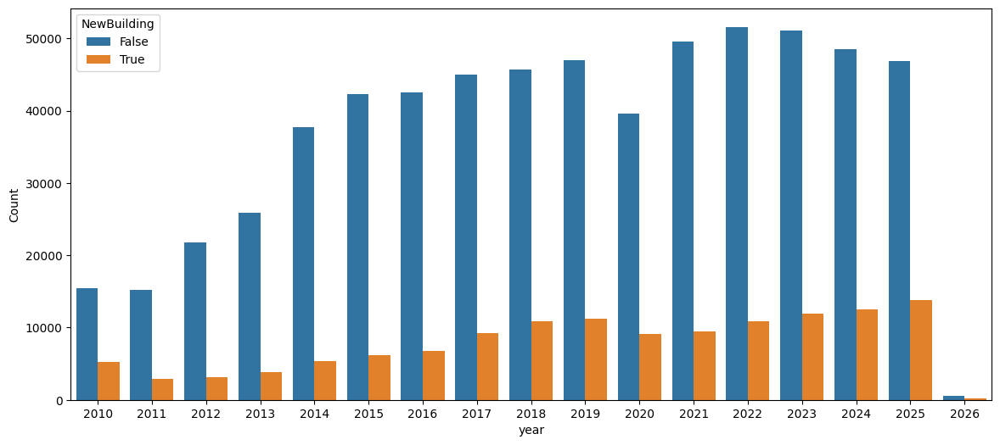

In [36]:
# Count of new and old buildings per year

plt.figure(figsize=(14, 6))
sns.barplot(
    x='year',
    y='NewBuilding',
    hue='NewBuilding',
    data=properties_dataset,
    estimator=lambda x: x.count(),  # or use len(x)
    errorbar=None
)
plt.ylabel('Count')
plt.show()

Este grafico nos muestra el crecimiento del mercado inmobiliario en Irl, en 2020 (COVID) hubo una baja que se recupero en 2021, se entiende que desde el 2012 la compra/venta de inmuebles viene con una tendencia creciente y nos da una idea que el mercado es interesante en este momento.
De 2011 a 2019 se ha casi triplicado la venda de viviendas nuevas, sin embargo no se ve que siga creciendo de la misma manera, esto nos daria una idea que si esta tendencia se mantiene el mercado de viviendas usadas seguira creciendo en valor.

In [37]:
# Drop everything above 2M and below 15k, anything above 2M is a luxury property or an office building and below 10k is a parking or an error
properties_dataset_no_extremes = properties_dataset.copy()
mask = properties_dataset_no_extremes['Price']>2000000  
properties_dataset_no_extremes = properties_dataset_no_extremes.drop(properties_dataset_no_extremes[mask].index)

mask = properties_dataset_no_extremes['Price']<15000
properties_dataset_no_extremes = properties_dataset_no_extremes.drop(properties_dataset_no_extremes[mask].index)

properties_dataset_no_extremes['year'] = pd.DatetimeIndex(properties_dataset_no_extremes['Date']).year
properties_dataset_no_extremes['month'] = pd.DatetimeIndex(properties_dataset_no_extremes['Date']).month

# Grafico de ventas de casas nuevas y viejas para entender tendencia del mercado

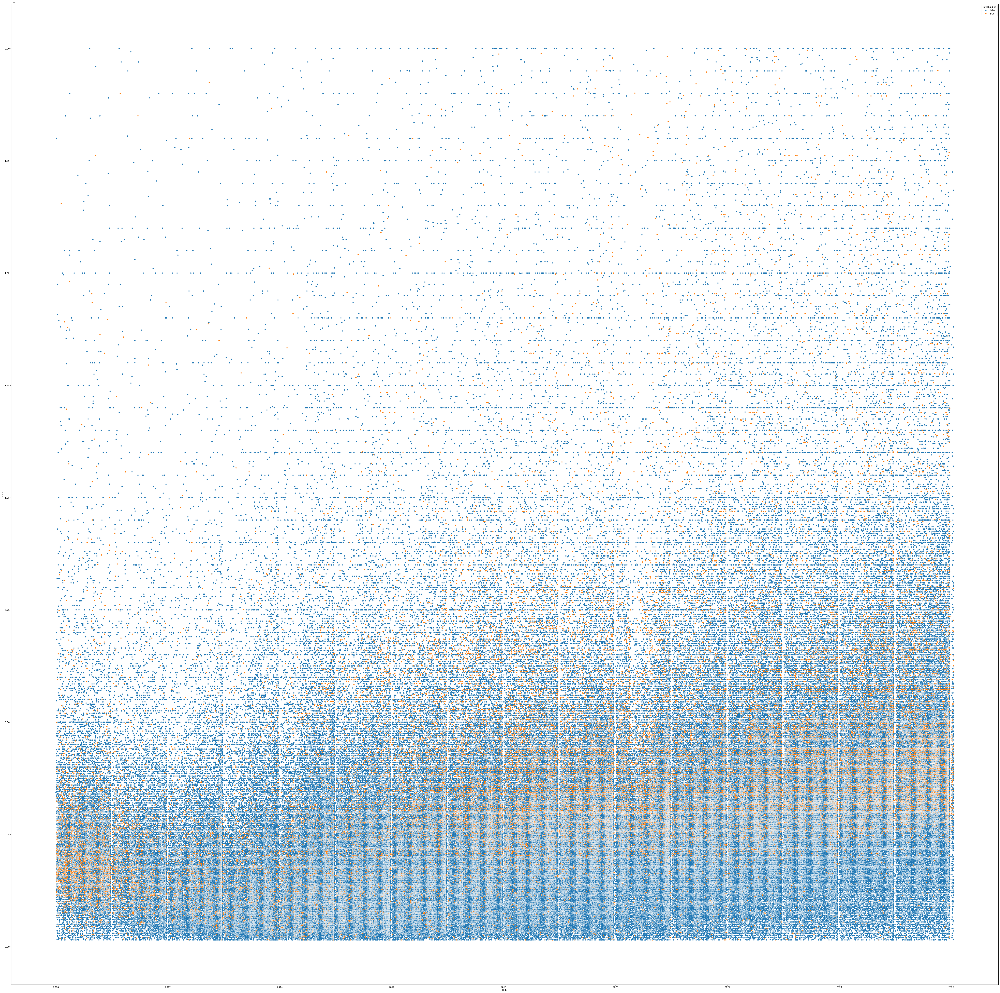

In [38]:


plt.figure(figsize=(80, 80))  # adjust as needed
#plt.xticks(rotation=90)

sns.scatterplot(x='Date',y='Price',hue='NewBuilding',data=properties_dataset_no_extremes)
plt.show()

Este grafico me resulta bastante interesante, en naranja estan las propiedades nuevas y en azul la de 2da mano.
Se aprecia que en 2010-11 el valor de las propiedades nuevas era entre 150k y 250k.<br>
Entre 2011-14 las propiedades nuevas y de 2da mano estan en similares precios, y se ve un descenso del precio en general de las propiedades (Concuerda con la crisis economica de Irl)<br>
En 2016 renace la venta de propiedades nuevas y todos los precios comienzan a aumentar, empiezan a aparecer muchas mas propiedades por encima del 1M que en 2010-2014 son casi inexistentes, el promedio valor de las casas nuevas esta por encima de los 250k.

De esto se puede deducir que el precio tanto de propiedades nuevas con 2da mano esta en alza.

Info de la crisis (by google):

La crisis económica en Irlanda entre 2011 y 2014 fue una prolongación de la crisis financiera global iniciada en 2008, que golpeó fuertemente al país debido a su sector bancario inflado y a la burbuja inmobiliaria. Esto llevó a Irlanda a una recesión y a solicitar un rescate financiero internaciona
Burbuja inmobiliaria y auge bancario:<br>
Irlanda experimentó un rápido crecimiento económico impulsado por un auge inmobiliario y un sector bancario expansivo, financiado por préstamos internacionale<br>
Recesión y rescate:<br>
La economía irlandesa entró en recesión, con una caída del PIB en el último trimestre de 2011. En 2010, Irlanda solicitó un rescate financiero internacional de 67.500 millones de euros a la UE y el FMI, debido a la incapacidad del gobierno para hacer frente a la deuda nacional con recortes de gastos y aumentos de impuestos<br>
Recuperación gradual:<br>
A pesar de las dificultades, Irlanda comenzó a mostrar signos de recuperación económica a partir de 2013-2014, con una disminución del desempleo y un crecimiento del PIB


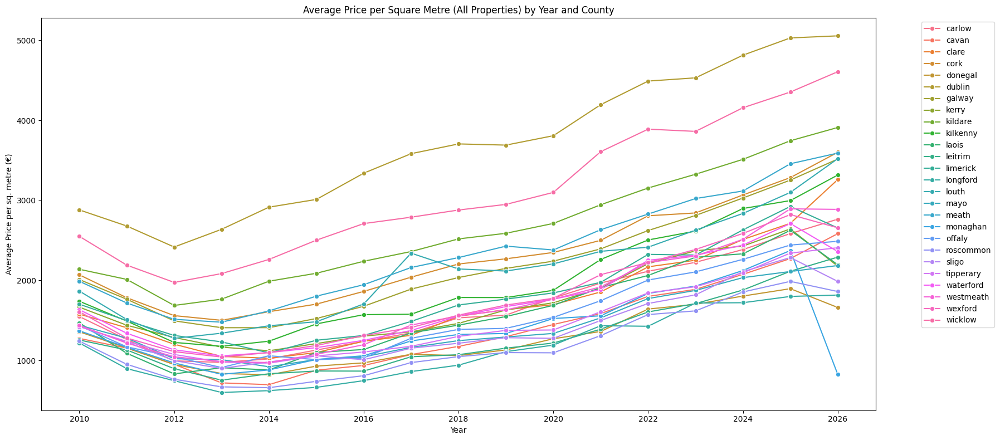

In [39]:
# Calculate average price per square metre for all properties by year and county
avg_sqmt_price = (
    properties_dataset_no_extremes.groupby(['year', 'County'])['Price_per_sq_metre']
    .mean()
    .reset_index()
)

plt.figure(figsize=(18, 8))
sns.lineplot(
    data=avg_sqmt_price,
    x='year',
    y='Price_per_sq_metre',
    hue='County',
    marker='o'
)
plt.title('Average Price per Square Metre (All Properties) by Year and County')
plt.ylabel('Average Price per sq. metre (€)')
plt.xlabel('Year')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


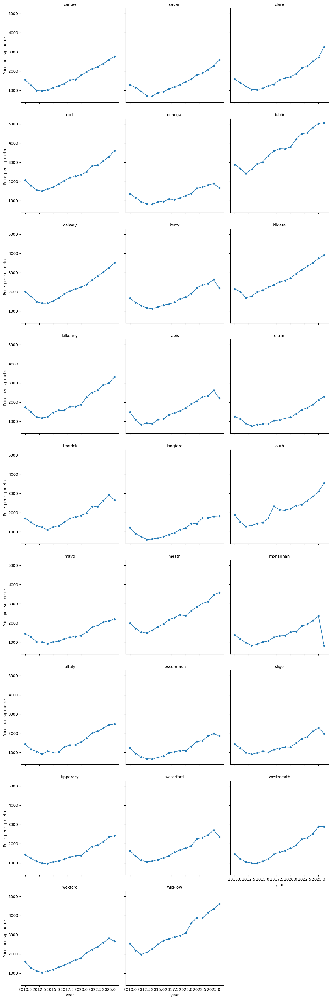

In [40]:
# Calculate average price per square metre for all properties by year and county
avg_sqmt_price = (
    properties_dataset_no_extremes.groupby(['year', 'County'])['Price_per_sq_metre']
    .mean()
    .reset_index()
)

top_counties = avg_sqmt_price['County'].value_counts().index # Option to add a filter but decided to display all counties
filtered = avg_sqmt_price[avg_sqmt_price['County'].isin(top_counties)]

g = sns.FacetGrid(filtered, col="County", col_wrap=3, height=4, sharey=True)
g.map_dataframe(sns.lineplot, x="year", y="Price_per_sq_metre", marker="o")
g.set_titles(col_template="{col_name}")
plt.show()

Entre estos 2 grafos se puede apreciar cuales son los 2 counties donde el precio de las viviendas es mayor y el crecimiento del precio por sq aumenta mas rapidamente. Esto concuerda con que son las ciudades mas grandes de Irl

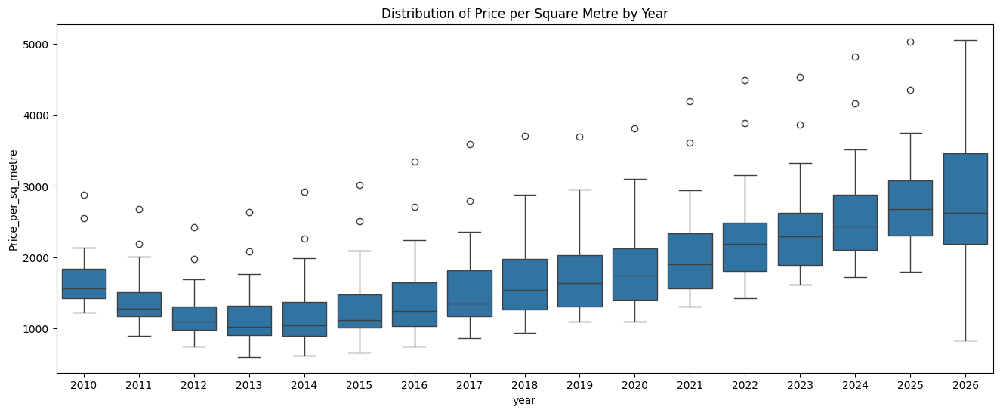

In [41]:
plt.figure(figsize=(16, 6))
sns.boxplot(x='year', y='Price_per_sq_metre', data=avg_sqmt_price)
plt.title("Distribution of Price per Square Metre by Year")
plt.show()

Un grafico que muestra la tendencia de crecimiento a partir de 2013 sin parar

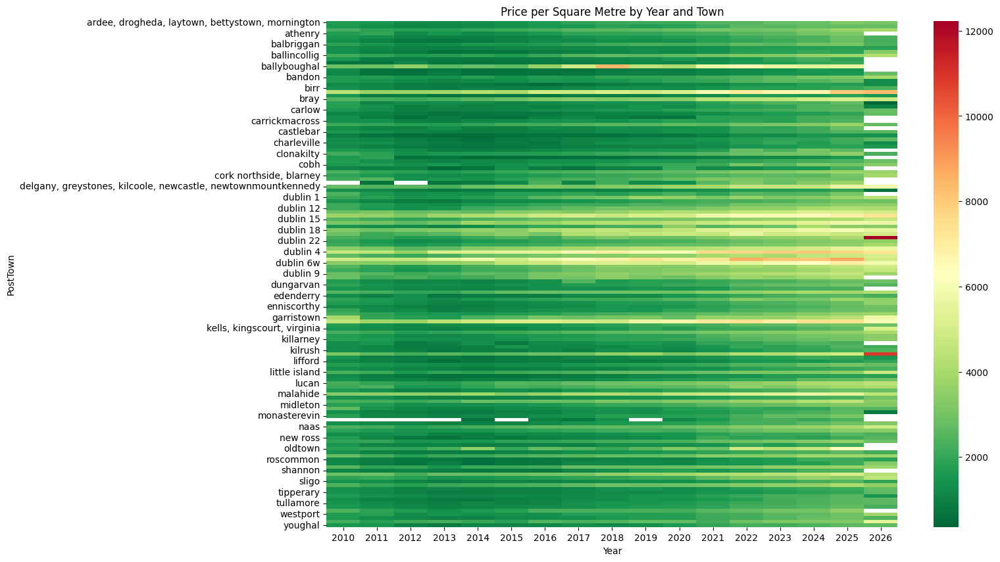

In [42]:
# Calculate average price per square metre for all properties by year and county
avg_sqmt_price_town = (
    properties_dataset_no_extremes.groupby(['year', 'PostTown'])['Price_per_sq_metre']
    .mean()
    .reset_index()
)


pivot = avg_sqmt_price_town.pivot(index='PostTown', columns='year', values='Price_per_sq_metre')
plt.figure(figsize=(14, 10))
sns.heatmap(pivot, cmap="RdYlGn_r")  # Reversed: green=cheaper, red=expensive
plt.title("Price per Square Metre by Year and Town")
plt.xlabel("Year")
plt.ylabel("PostTown")
plt.show()

Este grafico permite entender por EIR Code (el pueblo) la variacion del precio del sqmt.<br>
Algunas zonas que resaltan son:<br>
Dublin: Centro zonas 4, 6, 12, 18, Ballyboughal, Malahide<br>
Offaly: Garristown, Birr<br>
Interestante no ver algo que resalte en Cork siendo la 2da ciudad mas grande de Irl, se ve que todo mundo quiere vivir en Dublin y todas las zonas resaltadas son coincientemente de las mas bonitas actualmente.


In [43]:
def avg_sqmt_price_2025(properties_dataset):
    """
    Returns a DataFrame with the average price per square metre for each county in 2025.
    """
    # Ensure year column exists
    if 'year' not in properties_dataset.columns:
        properties_dataset['year'] = pd.DatetimeIndex(properties_dataset['Date']).year

    df_2025 = properties_dataset[properties_dataset['year'] == 2025]
    result = (
        df_2025.groupby('County')['Price_per_sq_metre']
        .mean()
        .reset_index()
        .rename(columns={'Price_per_sq_metre': 'Avg_Price_per_sq_metre_2025'})
    )
    return result

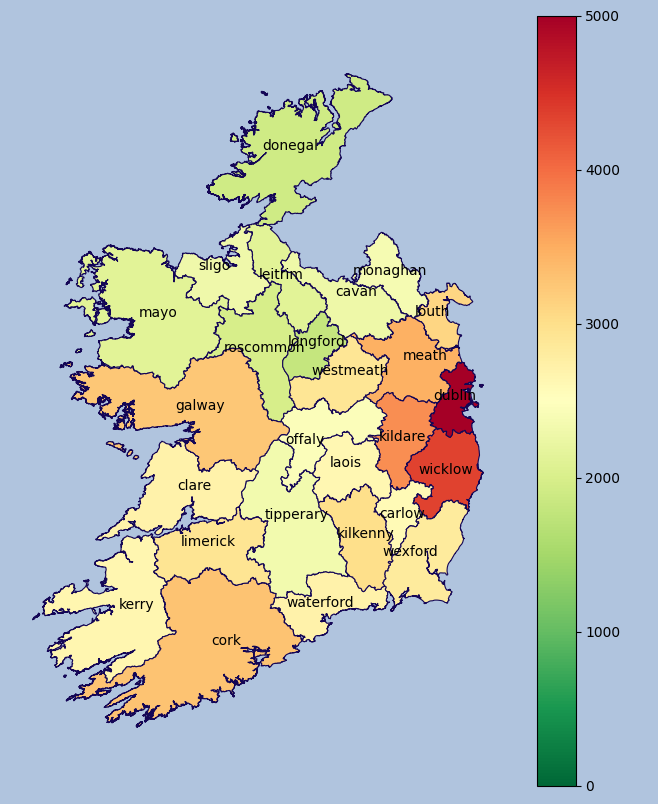

In [44]:
df = avg_sqmt_price_2025(properties_dataset_no_extremes)

irl_map = osp.join("res", "IRL_ADM1.shp")
ROI_map= gpd.read_file(irl_map)
ROI_map['NAME'] = ROI_map['NAME'].str.replace('County', '', regex=False).str.strip().str.lower()
ROI_map=ROI_map.set_index('NAME')

df=df.set_index('County')
df2= ROI_map.join(df)
df2['name'] = df2.index
MAP=df2
MAP['Avg_Price_per_sq_metre_2025'] = MAP['Avg_Price_per_sq_metre_2025'].fillna(0)

vmin, vmax = 0, 5000
fig, ax = plt.subplots(figsize=(8,10),facecolor='lightsteelblue')
fig=MAP.plot(column='Avg_Price_per_sq_metre_2025', cmap='RdYlGn_r', linewidth=0.8, ax=ax, edgecolor='#140656',facecolor='lightslategray',vmin=vmin, vmax=vmax,
legend=True, norm=plt.Normalize(vmin=vmin, vmax=vmax))
ax.axis('off')
ax.annotate('Avg_Price_per_sq_metre_2025',xy=(0.9, .65),rotation=270, xycoords='figure fraction', horizontalalignment='left', verticalalignment='top', fontsize=12, color='black')

#Getting the lan and lat here from geometry data    
MAP['coords']=MAP['geometry'].apply(lambda x: x.representative_point().coords[:])
MAP['coords']=[coords[0] for coords in MAP['coords']]

#Add names of county here
for idx, row in MAP.iterrows():
    plt.annotate(text=row['name'], xy=row['coords'],
             horizontalalignment='center', color='black', fontsize=10, fontweight='light')


Este ultimo grafico (el cual me costo muchisimo...) representa el mean de los precios de sqmt de 2025 por coutny.<br>
Dublin y cercanias son claramente las mas caras seguidas de Galway y de Cork.<br>
Algo interesante, Langford parace tener el precio mas bajos y esta bastante cerca de Dublin, podria ser una buena idea ver este condado como posible inversion.

## Estas son funciones viejas que utilize al comienzo para popular el codigo de ruta pero es muy lento


In [45]:
# Optional, not used!!

# Get missing EIRCODEs -- Access to the EIRCODE DB from the IRL gob costs 3000 EU
# Will be using the Eircode CSV file with the Routiong Key and the neighbourhoods to find the possible EIRRouteKey
# Select rows where Eircode is missing (nan or empty string)
# Takes around 4 minutes to run but it is worth it

missing_eircodes = properties_dataset[properties_dataset['EIRRouteKey'].isna()]


for index, row in missing_eircodes.iterrows():
    neighbourhood = row['Neighbourhood']
    area = row['Area']
    county = row['County']
    
    # Find matching EIRRouteKey in eircodes_csv matching the town which is the most accurate, the value muight be in the neighbourhood, area or county in this importance
    matching_eircodes = eircodes_csv[
        (eircodes_csv['PostTown'] == neighbourhood) | 
        (eircodes_csv['PostTown'] == area) | 
        (eircodes_csv['PostTown'] == county)
    ]
    
    if not matching_eircodes.empty:
        # If there are matches, assign the first one to the missing Eircode
        missing_eircodes.at[index, 'EIRRouteKey'] = matching_eircodes.iloc[0]['RoutingKey']
    else:
        # If no matches found, keep EIRRouteKey as NaN
        missing_eircodes.at[index, 'EIRRouteKey'] = np.nan

# Update the original DataFrame with the missing Eircodes
properties_dataset.update(missing_eircodes[['EIRRouteKey']])
# Went from 26% missing EIRRouteKey to 72% completeness for EIRRouteKey !!

completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")

Completeness of EIRRouteKey: 100.00%


In [46]:
# Optional, not used!!
# 202k missing * 268K unique options * 3 combinations if -- This will take a while.... 291Min
import os

cont = 0

for index, row in missing_eircodes.iterrows():
    SRoad = row['SRoad']
    neighbourhood = row['Neighbourhood']
    area = row['Area']
    county = row['County']
    cont += 1
    if cont % 10000 == 0:
        print("Procesado:", cont)

    # Find matching combinations of County with the other elements since they wont repeat by county if they match.
    matching_eircodes = neighbours_dataset[
        ((neighbours_dataset['County'] == county) & (neighbours_dataset['SRoad'] == SRoad)) |
        ((neighbours_dataset['County'] == county) & (neighbours_dataset['Neighbourhood'] == SRoad)) |
        ((neighbours_dataset['County'] == county) & (neighbours_dataset['Area'] == SRoad))
    ]
    
    if not matching_eircodes.empty:
        # If there are matches, assign the first one to the missing Eircode
        missing_eircodes.at[index, 'EIRRouteKey'] = matching_eircodes.iloc[0]['EIRRouteKey']
    else:
        # If no matches found, keep EIRRouteKey as NaN
        missing_eircodes.at[index, 'EIRRouteKey'] = np.nan
    

# Update the original DataFrame with the missing Eircodes
properties_dataset.update(missing_eircodes[['EIRRouteKey']])

completeness = properties_dataset['EIRRouteKey'].notna().mean() * 100
print(f"Completeness of EIRRouteKey: {completeness:.2f}%")

# Save the cleaned dataset to a new CSV file
output_csv = os.path.join("res", "PPR-ALL-cleaned2.csv")
properties_dataset.to_csv(output_csv, index=False, encoding='utf-8-sig')
print(f"Dataset cleaned and saved to {output_csv}")

Completeness of EIRRouteKey: 100.00%
Dataset cleaned and saved to res\PPR-ALL-cleaned2.csv


# Conclusiones

Hemos trabajado arduamente sobre un dataset con 15 años de informacion de compra y venta de inmuebles en Irelanda.<br>
Para poder hace uso fue necesario aplicar muchas tecnicas que permitiera reconstruir datas incompletos y limpiar informacion ya que a lo largo de los años el gobierno de Irl fue agregando mas columnas y no actulizo las viejas.<br>
La mayor dificultad ha estado en el trabajo del dataset, lo que ha requerido casi unas 40 hrs... y el ultimo grafico que fue muy interesante desarrollar.<br>

Concluciones utiles de la informacion y los graficos:<br>
Se pueden apreciar los porblemas economicos y el impacto del COVID en el mercado inmobiliario, asi como tambien la tendencia claramente creciente en los movimientos de compra y venta.<br>
Interesantemente no parece haber tanto crecimiento en lo que respecta a vivienda nueva en los ultimo años lo cual representa un crecimiento en los precios de las de 2da mano problablemente un problema habitacional para el pais.<br>
Se nota una tendencia hacia la preferencia de los inmuebles cerca de las grandes ciudades y con mucha ventaja Dublin y alrededores.<br>

Si uno quisiera comprar para invertir/alquilar tendria que ser en alguno de las 3 areas ciudades mas pobladas (Dulin y alrededores, Cork y Galway) pero si es para vivir y no es un requerimiento la vida urbana Langford parece ser la mejor opcion en relacion precio y cercania con Dublin.<br>

Personalmente esto ha sido muy interesante, algunos datos observados me han sorprendido mientras que otros han validado algunas de mis hipetesis. Como continuacion de este trabajo seria interesante entrenar una IA que permita estimar el valor potencial de inversion de una propiedad en base el EIRCode y el tamaño de la vivienda.